# IAU Projekt 2.fáza 
### Autori: Peter Plevko (50%), Radovan Cyprich (50%)                                                                        
### Dátum: 

In [154]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib as mat
import matplotlib.pylab as pylab
import statsmodels.api as sm
import statsmodels.stats as sm_stats
import statsmodels.stats.api as sms
import scipy.stats as stats
from matplotlib import pyplot
from collections import Counter
from datetime import datetime, date

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import MinMaxScaler

# Načítanie údajov z datasetu

In [155]:
ourdataset="061/merged.csv"
merged = pd.read_csv(ourdataset, sep=',')

## Atribút unnamed

Ako prvé si z datasetu odstránime nepotrebný atribút *Unnamed*, ktorý nám len označuje index záznamu. Vymažeme si ho aj kvôli tomu aby sa nám podarilo zistiť, či sa v datasete nachádzajú nejaké duplicitné záznamy. Tento atribút nemá pre nás žiadnu výpovednú hodnotu.

In [156]:
transformed = merged.iloc[: , 1:]

In [157]:
transformed.head()

,relationship,smoker,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,ssn,erytrocyty,indicator,hbver,leukocyty,alt,etytr,name,residence,blood_group,birthdate,address,race,job,sex
0,divorced,yes,69.29754,96.36107,6.16009,5.43057,5.33106,51.19736,48.65497,470-64-4139,3.13135,1.0,5.92815,5.68391,4.52772,6.41607,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,M
1,single,yes,72.82074,48.08581,5.34360,5.93857,5.38394,55.26958,64.91090,470-64-4139,7.68942,1.0,5.03657,4.95397,12.80219,6.26050,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,M
2,widowed,no,20.71153,84.24071,7.86501,5.29297,8.64115,53.49391,55.51303,470-64-4139,6.08545,1.0,7.23386,6.68762,6.98207,7.43575,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,M
3,married,no,71.48080,78.61777,7.63083,4.34763,7.07119,57.12180,56.47341,470-64-4139,4.30892,1.0,5.02865,6.28806,5.12203,6.48746,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,M
4,separated,yes,77.14564,87.14201,7.56648,5.49149,6.93812,62.31427,41.80988,579-65-9832,6.34564,0.0,5.54724,5.75947,7.19988,7.18319,Christopher Kirk,"280 Matthew Station\nLake Kevintown, ID 24849",A-,1989-06-30,"PSC 6508, Box 2850\nAPO AP 67161",Asian,Mudlogger,M


## Atribúty sex a smoker

Atribúty sex a smoker, ktoré nám vypovedajú o pravdivostných hodnotách jednotlivých vlastností pacientov, sme si nahradili číselnými atribútmi 1 a 0. Tieto atribúty neobsahujú, žiadne nan hodnoty.

In [158]:
print(len((transformed[transformed.sex.isnull()])))

0


In [159]:
print(len((transformed[transformed.smoker.isnull()])))

0


In [160]:
transformed['sex'] = transformed['sex'].str.replace('M',"1")
transformed['sex'] = transformed['sex'].str.replace('F',"0")
transformed['smoker'] = transformed['smoker'].str.replace('yes',"1")
transformed['smoker'] = transformed['smoker'].str.replace('no',"0")
transformed['smoker'] = transformed['smoker'].str.replace('Y',"1")
transformed['smoker'] = transformed['smoker'].str.replace('N',"0")

In [161]:
transformed.sex.unique()

array(['1', '0'], dtype=object)

In [162]:
transformed.smoker.unique()

array(['1', '0'], dtype=object)

## Vytvorenie atribútu age podľa atribútu birthdate

In [163]:
def age(born):
    born = datetime.strptime(born, "%Y-%m-%d").date()
    today = date.today()
    return today.year - born.year - ((today.month,today.day) < (born.month,born.day))
  
transformed['age'] = transformed['birthdate'].apply(age)

In [164]:
transformed.head()

,relationship,smoker,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,ssn,erytrocyty,indicator,hbver,leukocyty,alt,etytr,name,residence,blood_group,birthdate,address,race,job,sex,age
0,divorced,1,69.29754,96.36107,6.16009,5.43057,5.33106,51.19736,48.65497,470-64-4139,3.13135,1.0,5.92815,5.68391,4.52772,6.41607,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
1,single,1,72.82074,48.08581,5.34360,5.93857,5.38394,55.26958,64.91090,470-64-4139,7.68942,1.0,5.03657,4.95397,12.80219,6.26050,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
2,widowed,0,20.71153,84.24071,7.86501,5.29297,8.64115,53.49391,55.51303,470-64-4139,6.08545,1.0,7.23386,6.68762,6.98207,7.43575,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
3,married,0,71.48080,78.61777,7.63083,4.34763,7.07119,57.12180,56.47341,470-64-4139,4.30892,1.0,5.02865,6.28806,5.12203,6.48746,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
4,separated,1,77.14564,87.14201,7.56648,5.49149,6.93812,62.31427,41.80988,579-65-9832,6.34564,0.0,5.54724,5.75947,7.19988,7.18319,Christopher Kirk,"280 Matthew Station\nLake Kevintown, ID 24849",A-,1989-06-30,"PSC 6508, Box 2850\nAPO AP 67161",Asian,Mudlogger,1,32


## Atribút relationship

Keďže strojové učenie nevie pracovat s nenumerickými hodnotami rozhodli sme sa rozdeliť si pacientov na tých, ktorí majú partnera a tých, čo nie. V stĺpci relationship nahradíme hodnoty za 1 pre pacientov, čo majú partnera a 0 pre tých,čo nie.

In [165]:
transformed['relationship'] = transformed['relationship'].str.replace('divorced',"0")
transformed['relationship'] = transformed['relationship'].str.replace('single',"0")
transformed['relationship'] = transformed['relationship'].str.replace('separated',"0")
transformed['relationship'] = transformed['relationship'].str.replace('widowed',"0")
transformed['relationship'] = transformed['relationship'].str.replace('nop',"0")
transformed['relationship'] = transformed['relationship'].str.replace('married',"1")

In [166]:
transformed.relationship.unique()

array(['0', '1'], dtype=object)

In [167]:
transformed.head()

,relationship,smoker,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,ssn,erytrocyty,indicator,hbver,leukocyty,alt,etytr,name,residence,blood_group,birthdate,address,race,job,sex,age
0,0,1,69.29754,96.36107,6.16009,5.43057,5.33106,51.19736,48.65497,470-64-4139,3.13135,1.0,5.92815,5.68391,4.52772,6.41607,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
1,0,1,72.82074,48.08581,5.34360,5.93857,5.38394,55.26958,64.91090,470-64-4139,7.68942,1.0,5.03657,4.95397,12.80219,6.26050,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
2,0,0,20.71153,84.24071,7.86501,5.29297,8.64115,53.49391,55.51303,470-64-4139,6.08545,1.0,7.23386,6.68762,6.98207,7.43575,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
3,1,0,71.48080,78.61777,7.63083,4.34763,7.07119,57.12180,56.47341,470-64-4139,4.30892,1.0,5.02865,6.28806,5.12203,6.48746,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",B-,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",Black,Information officer,1,3
4,0,1,77.14564,87.14201,7.56648,5.49149,6.93812,62.31427,41.80988,579-65-9832,6.34564,0.0,5.54724,5.75947,7.19988,7.18319,Christopher Kirk,"280 Matthew Station\nLake Kevintown, ID 24849",A-,1989-06-30,"PSC 6508, Box 2850\nAPO AP 67161",Asian,Mudlogger,1,32


## Atribút race

Chceme docieliť, aby sme aj so string atribútmi mohli pracovať s numerickými atribútmi, preto nahradíme jednotlivé typy rás za čísla.

**Black - 1**

**Asian - 2**

**White - 3**

**Indian - 4**

**Hawaiian - 5**

In [168]:
transformed.race.unique()

array(['Black', 'Asian', 'White', 'Indian', 'Hawaiian'], dtype=object)

In [169]:
transformed['race'] = transformed['race'].str.replace('Black',"1")
transformed['race'] = transformed['race'].str.replace('Asian',"2")
transformed['race'] = transformed['race'].str.replace('White',"3")
transformed['race'] = transformed['race'].str.replace('Indian',"4")
transformed['race'] = transformed['race'].str.replace('Hawaiian',"5")

A- = -1

A+ = 1

B- = -2

B+ = 2

AB- = -3

AB+ = 3

O- = -4

O+ = 4


In [170]:
transformed['blood_group'] = transformed['blood_group'].str.replace('AB-',"-3")
transformed['blood_group'] = transformed['blood_group'].str.replace('AB+','3')

transformed['blood_group'] = transformed['blood_group'].str.replace('A-',"-1")
transformed['blood_group'] = transformed['blood_group'].str.replace('A+',"1")

transformed['blood_group'] = transformed['blood_group'].str.replace('B-',"-2")
transformed['blood_group'] = transformed['blood_group'].str.replace('B+',"2")

transformed['blood_group'] = transformed['blood_group'].str.replace('O-',"-4")
transformed['blood_group'] = transformed['blood_group'].str.replace('O+',"4")

C:\Users\pplev\AppData\Local\Temp/ipykernel_19180/705393224.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  transformed['blood_group'] = transformed['blood_group'].str.replace('AB+','3')
C:\Users\pplev\AppData\Local\Temp/ipykernel_19180/705393224.py:5: FutureWarning: The default value of regex will change from True to False in a future version.
  transformed['blood_group'] = transformed['blood_group'].str.replace('A+',"1")
C:\Users\pplev\AppData\Local\Temp/ipykernel_19180/705393224.py:8: FutureWarning: The default value of regex will change from True to False in a future version.
  transformed['blood_group'] = transformed['blood_group'].str.replace('B+',"2")
C:\Users\pplev\AppData\Local\Temp/ipykernel_19180/705393224.py:11: FutureWarning: The default value of regex will change from True to False in a future version.
  transformed['blood_group'] = transformed['blood_group'].str.replace('O+',"4")


In [171]:
for x in transformed['blood_group']:
    if(x=='1+'):
        newString = 1
        transformed['blood_group'] = transformed['blood_group'].replace(x, newString)
    elif(x=='2+'):
        newString = 2
        transformed['blood_group'] = transformed['blood_group'].replace(x, newString)
    elif(x=='3+'):
        newString = 3
        transformed['blood_group'] = transformed['blood_group'].replace(x, newString)
    elif(x=='4+'):
        newString = 4
        transformed['blood_group'] = transformed['blood_group'].replace(x, newString)

In [172]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
print(transformed['blood_group'])

0       -2
1       -2
2       -2
3       -2
4       -1
5       -1
6       -1
7       -1
8        1
9        1
10       1
11       3
12       3
13       3
14       3
15       3
16       3
17      -3
18      -3
19      -3
20      -3
21      -2
22      -2
23      -2
24      -2
25       1
26       1
27       1
28       3
29       3
30       3
31      -2
32      -2
33      -2
34      -4
35      -4
36      -4
37      -2
38      -2
39      -2
40      -4
41      -4
42      -4
43       1
44       1
45       1
46       3
47       3
48       3
49       3
50       3
51       3
52       3
53       3
54       2
55       2
56      -3
57      -3
58      -3
59      -4
60      -4
61      -4
62      -4
63      -4
64      -4
65      -4
66      -4
67      -3
68      -3
69      -3
70      -3
71      -2
72      -2
73      -2
74      -2
75       4
76       4
77       4
78      -2
79      -2
80      -2
81      -2
82      -1
83      -1
84      -1
85       2
86       2
87       2
88      -2
89      -2
90      -2

In [173]:
transformed.race.unique()

array(['1', '2', '3', '4', '5'], dtype=object)

## Atribút job

V tomto stĺpci sa nachádza veľmi veľa podobných hodnôt, ako napríklad viacero typov učiteľov, inžinierov, doktorov, IT špecialostov a ďalších. Preto sme sa rozhodli niektoré tieto povolania zjednotiť do jednoho všeobecnejšieho.

In [174]:
a=transformed['job'].unique()
print(sorted(a))

['Academic librarian', 'Accommodation manager', 'Accountant, chartered', 'Accountant, chartered certified', 'Accountant, chartered management', 'Accountant, chartered public finance', 'Accounting technician', 'Actor', 'Actuary', 'Acupuncturist', 'Administrator', 'Administrator, Civil Service', 'Administrator, arts', 'Administrator, charities/voluntary organisations', 'Administrator, education', 'Administrator, local government', 'Administrator, sports', 'Adult guidance worker', 'Adult nurse', 'Advertising account executive', 'Advertising account planner', 'Advertising art director', 'Advertising copywriter', 'Advice worker', 'Aeronautical engineer', 'Agricultural consultant', 'Agricultural engineer', 'Aid worker', 'Air broker', 'Air cabin crew', 'Air traffic controller', 'Airline pilot', 'Ambulance person', 'Amenity horticulturist', 'Analytical chemist', 'Animal nutritionist', 'Animal technologist', 'Animator', 'Applications developer', 'Arboriculturist', 'Archaeologist', 'Architect', 

## Odstráňovanie vychýlených hodnôt

Prejdeme si všetky stĺpce ako sú na tom vychýlené hodnoty a potom využijeme funckiu, ktorou vychýlení hodnoty priradíme do kvantilov. Vo funkcii sa využíva transformácia pomocou logaritmu a zároveň 5 a 95 percentil. 

Keďže sme niektoré vychýlené hodnoty odstránili už v prvej fáze, napríklad pri atribúte weight, pozrieme sa na nahradenie vychýlených hodnôt hraničnými hodnotami rozdelenia.

In [175]:
def use_quantiles(df, column):
    new_df = df.copy(deep = True)
    skew_val = stats.skew(new_df[column]) 
    
    if ((skew_val < -2) or (skew_val > 2)):  
        minimum = new_df[column].min()
        minimum = minimum + (-minimum - minimum)
        new_df[column] = np.log(new_df[column]+minimum)
    
    perc_95 = new_df[column].quantile(.95)   
    perc_05 =  new_df[column].quantile(.05)
    new_df.loc[new_df[column] < perc_05, column] = perc_05
    new_df.loc[new_df[column] > perc_95, column] = perc_95
    return new_df

In [176]:
transformed = use_quantiles(transformed, 'alp')
transformed = use_quantiles(transformed, 'weight')
transformed = use_quantiles(transformed, 'trombocyty')
transformed = use_quantiles(transformed, 'hematokrit')
transformed = use_quantiles(transformed, 'hemoglobin')
transformed = use_quantiles(transformed, 'ast')
transformed = use_quantiles(transformed, 'erytrocyty')
transformed = use_quantiles(transformed, 'hbver')
transformed = use_quantiles(transformed, 'leukocyty')
transformed = use_quantiles(transformed, 'alt')
transformed = use_quantiles(transformed, 'etytr')

c:\users\pplev\onedrive\počítač\inteligentná analýza údajov\zadanie\zadanie 2 faza\env_name\lib\site-packages\pandas\core\arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [177]:
transformed.head()

,relationship,smoker,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,ssn,erytrocyty,indicator,hbver,leukocyty,alt,etytr,name,residence,blood_group,birthdate,address,race,job,sex,age
0,0,1,69.29754,96.36107,6.160090,5.43057,5.33106,51.19736,48.65497,470-64-4139,3.242822,1.0,5.92815,5.68391,1.510219,6.41607,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",-2,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",1,Information officer,1,3
1,0,1,72.82074,48.08581,5.561651,5.93857,5.38394,55.26958,64.91090,470-64-4139,7.689420,1.0,5.03657,4.95397,2.549616,6.26050,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",-2,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",1,Information officer,1,3
2,0,0,20.71153,84.24071,7.865010,5.29297,8.64115,53.49391,55.51303,470-64-4139,6.085450,1.0,7.23386,6.68762,1.943345,7.43575,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",-2,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",1,Information officer,1,3
3,1,0,71.48080,78.61777,7.630830,4.34763,7.07119,57.12180,56.47341,470-64-4139,4.308920,1.0,5.02865,6.28806,1.633551,6.48746,Peter Caldwell,"205 Mary Expressway\nSouth Joseph, MS 59705",-2,2018-10-03,"6123 Davis Plain Suite 596\nJoshuaton, WY 57242",1,Information officer,1,3
4,0,1,77.14564,87.14201,7.566480,5.49149,6.93812,62.31427,41.80988,579-65-9832,6.345640,0.0,5.54724,5.75947,1.974064,7.18319,Christopher Kirk,"280 Matthew Station\nLake Kevintown, ID 24849",-1,1989-06-30,"PSC 6508, Box 2850\nAPO AP 67161",2,Mudlogger,1,32


# Realizácia predspracovania dát

Rozhodli sme sa rozdeliť si dataset na testovaciu a trénovaciu množinu v pomere 1:4 teda 20% dát tvoria testovacie dáta a 80% trénovacie dáta. Ďalej budeme spracovávať trénovaciu vzorku.

In [178]:
len(transformed)

9702

In [179]:
train_data, test_data = train_test_split(transformed, test_size=0.2)
print('Trénovací dataset obsahuje:'+ str(len(train_data))+' záznamov\n'+'Testovacia vzorka obsahuje:'+  str(len(test_data))+' záznamov')

Trénovací dataset obsahuje:7761 záznamov
Testovacia vzorka obsahuje:1941 záznamov


Nase hodnoty su odseba velmi rozdielne preto pouzijem scaling

In [180]:
df_scaled = train_data.copy()
col_names = ['alp', 'weight', 'trombocyty', 'hematokrit', 'hemoglobin', 'er-cv', 'ast', 'erytrocyty', 'hbver', 'leukocyty', 'alt', 'etytr']
features = df_scaled[col_names]
features

,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,erytrocyty,hbver,leukocyty,alt,etytr
5675,63.321850,89.110140,7.111660,4.712330,5.068960,71.323090,26.152471,5.221020,6.290430,6.172830,1.258354,4.468434
3027,55.627440,108.168890,6.790430,5.755970,7.522850,58.786680,48.992720,5.895440,7.235370,4.479043,1.644880,6.312140
8288,15.456960,96.560540,8.418540,7.923240,3.510851,60.284240,57.454180,7.603770,7.719290,6.245910,2.519149,6.874370
6215,84.635920,127.387322,5.652660,6.660290,5.827260,74.881750,34.144620,7.374360,6.285100,5.458470,2.244282,6.106800
5981,88.416028,75.003180,6.207170,4.436180,6.425830,53.518950,56.179770,7.385480,5.671890,7.243010,2.265839,5.171330
3722,32.242520,121.265500,6.916680,3.814020,8.469420,46.010290,56.906600,6.808340,6.921200,5.464540,1.810138,4.468434
3478,19.809290,62.312250,8.953880,5.131100,8.602380,70.590670,34.438820,7.729380,5.481950,4.479043,2.607408,6.851700
5338,88.416028,102.189470,7.317450,3.496110,6.309150,33.512840,46.234620,3.454290,5.600880,5.810600,2.104660,7.189700
9297,50.911250,71.011650,7.361090,7.660920,4.702340,64.165710,42.995760,7.401940,5.957300,6.953050,1.962198,6.740680
6168,11.571520,127.387322,7.145590,4.246310,3.510851,52.740490,61.228050,6.778210,6.985870,6.496320,2.228050,6.726680


In [181]:
values = ['alp', 'weight', 'trombocyty', 'hematokrit', 'hemoglobin', 'er-cv', 'ast', 'erytrocyty', 'hbver', 'leukocyty', 'alt', 'etytr']
scaler = MinMaxScaler()
train_data[values] = scaler.fit_transform(train_data[values])
train_data

,relationship,smoker,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,ssn,erytrocyty,indicator,hbver,leukocyty,alt,etytr,name,residence,blood_group,birthdate,address,race,job,sex,age
5675,0,0,0.673442,0.645235,0.446200,0.305103,0.290797,0.713231,0.000000,342-20-3532,0.401305,0.0,0.554192,0.512177,0.000000,0.000000,Amy Norris,"579 Yolanda Crossroad\nHowemouth, AR 37388",-4,1970-04-05,"92077 Mays Parkways\nNew Robynbury, ND 23861",3,"Engineer, maintenance",0,51
3027,0,1,0.573313,0.821878,0.353728,0.516129,0.748779,0.587867,0.544964,195-47-0022,0.538120,1.0,0.838277,0.000000,0.259256,0.554524,Robert Johnson,"7443 Beverly Springs\nMartinezstad, FL 72301",3,1912-08-14,"0410 Pham Oval Apt. 932\nJohnsonmouth, OK 54461",4,Patent examiner,1,109
8288,0,1,0.050562,0.714288,0.822411,0.954354,0.000000,0.602842,0.746853,529-38-9956,0.884679,1.0,0.983762,0.534276,0.845657,0.723623,Peggy Ramirez,"9550 Dylan Crest Suite 853\nThomaston, SD 97961",-2,1926-05-17,USNS Martin\nFPO AP 25942,4,"Administrator, Civil Service",0,95
6215,0,0,0.950808,1.000000,0.026199,0.698984,0.432323,0.748818,0.190691,023-17-8575,0.838140,1.0,0.552590,0.296165,0.661294,0.492764,Jody Cochran,"1354 Jones Isle\nPort Hayley, GA 95752",1,1978-11-04,"066 Martinez Circles\nKathleenfort, MT 67985",3,Commercial horticulturist,0,43
5981,0,0,1.000000,0.514488,0.185825,0.249265,0.544037,0.535189,0.716446,845-84-4865,0.840396,0.0,0.368236,0.835785,0.675753,0.211407,Matthew Parker,"5329 Gregory Springs\nStewartland, WI 17579",-2,2007-07-13,Unit 7282 Box 3782\nDPO AP 88101,3,Web designer,1,14
3722,0,0,0.268998,0.943261,0.390071,0.123463,0.925442,0.460103,0.733788,786-03-0317,0.723315,1.0,0.743826,0.298000,0.370099,0.000000,Ricky Marks,"204 Selena Cliff\nEricksonburgh, VT 29966",-3,1987-10-31,"5014 Vance Harbors Suite 936\nRobertside, MS 9...",3,Editorial assistant,1,34
3478,0,1,0.107201,0.396864,0.976519,0.389779,0.950257,0.705907,0.197711,553-37-2002,0.910161,0.0,0.311132,0.000000,0.904855,0.716805,Joshua Garcia,"266 Mcneil Freeway\nEast Dennistown, KY 90342",-2,1988-10-12,"19691 Villa Parks Apt. 182\nPeterville, ME 71327",3,"Scientist, marine",1,33
5338,0,0,1.000000,0.766459,0.505441,0.059181,0.522260,0.335128,0.479156,507-64-9559,0.042899,1.0,0.346887,0.402644,0.567645,0.818464,Pamela Caldwell,4107 Preston Brooks Apt. 849\nEast Shannonport...,4,1999-03-13,"60700 Cameron Extensions\nAdkinshaven, OK 03439",1,Geophysicist/field seismologist,0,22
9297,0,0,0.511939,0.477493,0.518003,0.901313,0.222373,0.641657,0.401878,414-43-2447,0.843735,1.0,0.454041,0.748105,0.472091,0.683414,Theresa Pham,"7848 Matthew Path\nWest Sabrina, KY 88655",3,1946-09-12,80075 Johnson Mountains Suite 667\nNorth Taylo...,3,"Psychologist, sport and exercise",0,75
6168,0,0,0.000000,1.000000,0.455967,0.210873,0.000000,0.527405,0.836897,053-90-5729,0.717203,0.0,0.763268,0.609996,0.650407,0.679203,Kyle Smith,"91678 Meyers Glens Suite 798\nWest Juliemouth,...",1,1915-10-03,USNS Johnson\nFPO AE 97761,3,Bookseller,1,106


In [182]:
scaler = PowerTransformer(method = 'yeo-johnson')
df_scaled[col_names] = scaler.fit_transform(features.values)
df_scaled

,relationship,smoker,alp,weight,trombocyty,hematokrit,hemoglobin,er-cv,ast,ssn,erytrocyty,indicator,hbver,leukocyty,alt,etytr,name,residence,blood_group,birthdate,address,race,job,sex,age
5675,0,0,0.294641,0.609447,-0.216489,-0.655788,-0.658568,1.393446,-1.842046,342-20-3532,-0.699346,0.0,0.187331,0.076256,-1.856573,-1.829022,Amy Norris,"579 Yolanda Crossroad\nHowemouth, AR 37388",-4,1970-04-05,"92077 Mays Parkways\nNew Robynbury, ND 23861",3,"Engineer, maintenance",0,51
3027,0,1,-0.013978,1.182928,-0.554786,0.066307,0.903359,0.425971,0.181081,195-47-0022,-0.266139,1.0,1.210650,-1.827575,-0.821498,0.204494,Robert Johnson,"7443 Beverly Springs\nMartinezstad, FL 72301",3,1912-08-14,"0410 Pham Oval Apt. 932\nJohnsonmouth, OK 54461",4,Patent examiner,1,109
8288,0,1,-1.560362,0.836935,1.157832,1.487499,-1.766015,0.541155,0.887861,529-38-9956,1.036837,1.0,1.732536,0.155875,1.297831,0.808315,Peggy Ramirez,"9550 Dylan Crest Suite 853\nThomaston, SD 97961",-2,1926-05-17,USNS Martin\nFPO AP 25942,4,"Administrator, Civil Service",0,95
6215,0,0,1.163095,1.736251,-1.754752,0.670775,-0.155876,1.669331,-1.110524,023-17-8575,0.844674,1.0,0.181542,-0.712343,0.659535,-0.017763,Jody Cochran,"1354 Jones Isle\nPort Hayley, GA 95752",1,1978-11-04,"066 Martinez Circles\nKathleenfort, MT 67985",3,Commercial horticulturist,0,43
5981,0,0,1.318929,0.165216,-1.169575,-0.851924,0.227423,0.021719,0.782548,845-84-4865,0.853865,0.0,-0.485850,1.224514,0.710437,-1.043129,Matthew Parker,"5329 Gregory Springs\nStewartland, WI 17579",-2,2007-07-13,Unit 7282 Box 3782\nDPO AP 88101,3,Web designer,1,14
3722,0,0,-0.930844,1.562402,-0.421804,-1.302760,1.462760,-0.551828,0.842658,786-03-0317,0.393386,1.0,0.871065,-0.705559,-0.399552,-1.829022,Ricky Marks,"204 Selena Cliff\nEricksonburgh, VT 29966",-3,1987-10-31,"5014 Vance Harbors Suite 936\nRobertside, MS 9...",3,Editorial assistant,1,34
3478,0,1,-1.400387,-0.252445,1.719948,-0.362574,1.539757,1.336730,-1.084157,553-37-2002,1.144317,0.0,-0.693146,-1.827575,1.498074,0.784097,Joshua Garcia,"266 Mcneil Freeway\nEast Dennistown, KY 90342",-2,1988-10-12,"19691 Villa Parks Apt. 182\nPeterville, ME 71327",3,"Scientist, marine",1,33
5338,0,0,1.318929,1.005925,0.000128,-1.538405,0.153568,-1.498180,-0.053435,507-64-9559,-1.617634,1.0,-0.563316,-0.321219,0.326164,1.144100,Pamela Caldwell,4107 Preston Brooks Apt. 849\nEast Shannonport...,4,1999-03-13,"60700 Cameron Extensions\nAdkinshaven, OK 03439",1,Geophysicist/field seismologist,0,22
9297,0,0,-0.201635,0.035882,0.046054,1.320245,-0.909329,0.840203,-0.331732,414-43-2447,0.867493,1.0,-0.174879,0.917009,-0.020884,0.665343,Theresa Pham,"7848 Matthew Path\nWest Sabrina, KY 88655",3,1946-09-12,80075 Johnson Mountains Suite 667\nNorth Taylo...,3,"Psychologist, sport and exercise",0,75
6168,0,0,-1.700551,1.736251,-0.180768,-0.988148,-1.766015,-0.037895,1.197548,053-90-5729,0.370273,0.0,0.941018,0.427296,0.621109,0.650349,Kyle Smith,"91678 Meyers Glens Suite 798\nWest Juliemouth,...",1,1915-10-03,USNS Johnson\nFPO AE 97761,3,Bookseller,1,106


# Výber atribútov pre strojové učenie

In [183]:
transformed["smoker"] = pd.to_numeric(transformed["smoker"])
transformed["relationship"] = pd.to_numeric(transformed["relationship"])
transformed["race"] = pd.to_numeric(transformed["race"])
transformed["sex"] = pd.to_numeric(transformed["sex"])
transformed["smoker"] = pd.to_numeric(transformed["smoker"])
transformed["blood_group"] = pd.to_numeric(transformed["blood_group"])
transformed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9702 entries, 0 to 9701
Data columns (total 25 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   relationship  9702 non-null   int64  
 1   smoker        9702 non-null   int64  
 2   alp           9702 non-null   float64
 3   weight        9702 non-null   float64
 4   trombocyty    9702 non-null   float64
 5   hematokrit    9702 non-null   float64
 6   hemoglobin    9702 non-null   float64
 7   er-cv         9702 non-null   float64
 8   ast           9702 non-null   float64
 9   ssn           9702 non-null   object 
 10  erytrocyty    9702 non-null   float64
 11  indicator     9702 non-null   float64
 12  hbver         9702 non-null   float64
 13  leukocyty     9702 non-null   float64
 14  alt           9702 non-null   float64
 15  etytr         9702 non-null   float64
 16  name          9702 non-null   object 
 17  residence     9702 non-null   object 
 18  blood_group   9702 non-null 

<AxesSubplot:>

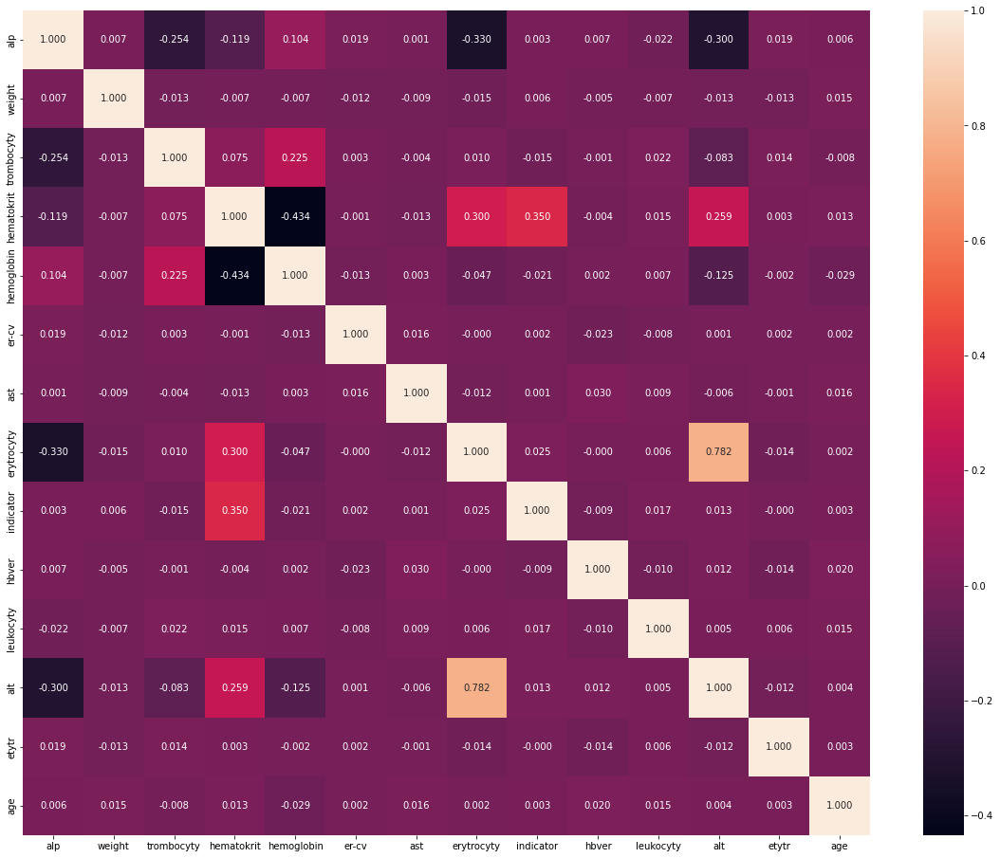

In [184]:
figure, ax = plt.subplots(figsize=(20,16))
sns.heatmap(train_data.corr(),ax=ax, annot =True, fmt = ".3f")